# Lab Session

## Students Details:
* Guy Kabiri 312252224
* Tomer Dwek 313229486
* Tal Goldengoren 207042573


## Imports





In [1]:
import gc
import numpy as np
import cv2
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import datasets, models, transforms
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix

from  functools import reduce
from matplotlib import pyplot as plt
import seaborn as sns
from google.colab import drive
import os 
import zipfile
import glob
import albumentations as A

In [2]:
!pip install torchmetrics timm

     |████████████████████████████████| 276kB 9.0MB/s 
     |████████████████████████████████| 296kB 20.5MB/s 


In [3]:
import torchmetrics 

In [4]:
!pip install -U git+https://github.com/albu/albumentations > /dev/null

  Running command git clone -q https://github.com/albu/albumentations /tmp/pip-req-build-rt0_a7xx


In [5]:
from albumentations.pytorch import ToTensorV2

In [6]:
pip install timm

In [7]:
import timm

In [8]:
from torch.utils.tensorboard import SummaryWriter
%load_ext tensorboard 
# %reload_ext tensorboard

## General Definitions

In [9]:
SEED = 0
np.random.seed(SEED)

BATCH_SIZE = 32
NUM_CLASSES = 3

In [10]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

## Importing Data

In [11]:
drive.mount("/content/drive", force_remount=True)

Mounted at /content/drive


In [12]:
GOOGLE_DRIVE_PATH_AFTER_MY_DRIVE = 'Colab Notebooks/Computer Vision/Lab 8'
GOOGLE_DRIVE_PATH = os.path.join('drive', 'My Drive', GOOGLE_DRIVE_PATH_AFTER_MY_DRIVE)

In [13]:
archive_path = os.path.join(GOOGLE_DRIVE_PATH, 'archive2.zip')
# archive_path = os.path.join(GOOGLE_DRIVE_PATH, 'archive3.zip')

In [14]:
dir_to_extract = ''

In [15]:
with zipfile.ZipFile(archive_path, 'r') as zip_ref:
    zip_ref.extractall(dir_to_extract)

### Dataset Class

In [17]:
class MyDataset(Dataset):
    def __init__(self, paths, transform=None, train=True, size=224):
        self.paths = paths
        self.transform = transform
        self.train = train
        self.size = size
    def __len__(self):
        return len(self.paths)
    
    def __getitem__(self, idx):
        p = self.paths[idx]
        label = p.split("/")[-2].split("_")[-1]
        image = cv2.imread(p)
        image = cv2.cvtColor(image,cv2.COLOR_BGR2RGB)
        
        if self.transform:
            image = self.transform(image=image)['image']

        return image, int(label) - 1 # label count starts from zero not 1 

### Dataloaders

In [18]:
def get_paths(data_path, split=1, drop_rate=0):
    images  = [glob.glob(os.path.join(data_path, d, "*.*")) for d in os.listdir(data_path)]
    all_paths = np.hstack(images)

    if drop_rate > 0:
        all_paths = all_paths[:int(len(all_paths) * (1 - drop_rate))]

    if split != 1:
        l = len(all_paths)
        np.random.shuffle(all_paths)
        top = int(l*split)
        train = all_paths[:top]
        test = all_paths[top:]
        return train, test
    return all_paths

In [19]:
# data_path = 'kaggle/train/train'
data_path = 'archive/kaggle/train/train'


train_paths, valid_paths = get_paths(data_path, 0.7)

# train_paths = get_paths(data_path, drop_rate=0.95)


print(f'In this training set we have got a total of {len(train_paths)}')
print(f'In this validation set we have got a total of {len(valid_paths)}')

In this training set we have got a total of 5365
In this validation set we have got a total of 2300


In [20]:
transform = A.Compose([
    # A.RandomBrightnessContrast(p=0.2),
    A.MotionBlur(blur_limit=10, p=0.5),
    A.Blur(blur_limit=10, p=0.5),
    ToTensorV2(),
    # A.HueSaturationValue(p=0.2),
    # A.MotionBlur(p=.2)
])

In [21]:
trainset    = MyDataset(train_paths, transform)
validset    = MyDataset(valid_paths, transform)

In [22]:
train_loader  = DataLoader(dataset=trainset, batch_size=BATCH_SIZE, shuffle=True)
valid_loader  = DataLoader(dataset=validset, batch_size=BATCH_SIZE, shuffle=True)

In [23]:
class AverageMeter(object):
    """Computes and stores the average and current value"""
    def __init__(self):
        self.reset()

    def reset(self):
        self.val = 0
        self.avg = 0
        self.sum = 0
        self.count = 0

    def update(self, val, n=1):
        self.val = val
        self.sum += val * n
        self.count += n
        self.avg = self.sum / self.count

In [24]:
def save_model(model, optimizer, epoch, loss, path):
    torch.save({
            'epoch': epoch,
            'model_state_dict': model.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
            'loss': loss,
            }, path)
  
def load_model(path, model, optimizer):
    checkpoint = torch.load(PATH)
    model.load_state_dict(checkpoint['model_state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    epoch = checkpoint['epoch']
    loss = checkpoint['loss']
    return epoch, loss

## Training and Validation Functions

In [25]:
def train(train_loader, model, optimizer, criterion, epoch, writer):
    gc.collect()
    torch.cuda.empty_cache()

    accuracy = AverageMeter()
    losses = AverageMeter()
    model.train()

    for i, (img, target) in enumerate(train_loader):
        img = img.float()    
        target = target.long()

        img = img.to(device)
        target = target.to(device)
        optimizer.zero_grad()
        output = model(img.float())

        loss = criterion(output, target)
        loss.backward()

        optimizer.step()
    
        pred = output.argmax(dim=1 , keepdim=True)
        acc = torchmetrics.functional.accuracy(pred, target)

        losses.update(loss.item(), img.size(0))
        accuracy.update(acc, img.size(0))

    writer.add_scalar('average loss', losses.avg, epoch + 1)
    writer.add_scalar('average accuracy', accuracy.avg, epoch + 1)
    return losses.avg, accuracy.avg

In [26]:
def validation(valid_loader, model, criterion, epoch, writer):
    gc.collect()
    torch.cuda.empty_cache()

    accuracy = AverageMeter()
    losses = AverageMeter()
    model.eval()

    with torch.no_grad():
        for i, (img, target) in enumerate(valid_loader):
            img = img.float()    
            target = target.long()

            img = img.to(device)
            target = target.to(device)
            output = model(img.float())

            loss = criterion(output, target)    

            pred = output.argmax(dim=1 , keepdim=True)
            acc = torchmetrics.functional.accuracy(pred, target)

            losses.update(loss.item(), img.size(0))
            accuracy.update(acc, img.size(0))

    writer.add_scalar('average loss', losses.avg, epoch + 1)
    writer.add_scalar('average accuracy', accuracy.avg, epoch + 1)
    return losses.avg, accuracy.avg

In [27]:
def train_model(train_loader, valid_loader, model, optimizer, criterion, start_epoch, epochs, writer_name, exp_num, scheduler=None):

    model = model.to(device)
    writer_train = SummaryWriter('runs/{}_train_{}'.format(writer_name, exp_num))
    writer_valid = SummaryWriter('runs/{}_valid_{}'.format(writer_name, exp_num))

    print('{} number {}'.format(writer_name, exp_num))

    best_valid_score = 0
    for epoch in range(start_epoch, start_epoch + epochs):
        train_loss, train_accuracy = train(train_loader, model, optimizer, criterion, epoch, writer_train)
        valid_loss, valid_accuracy = validation(valid_loader, model, criterion, epoch, writer_valid)
        if scheduler:
            scheduler.step()
        print('Epoch {:3d}:\ttrain loss: {:g},\ttrain accuracy: {:g},\tvalidation loss: {:g},\tvalidation accuracy: {:g}'.format(epoch + 1, train_loss, train_accuracy, valid_loss, valid_accuracy))

        if valid_accuracy > best_valid_score:
            path = '{}{}.pth'.format(writer_name, exp_num)
            save_model(model, optimizer, epochs, valid_loss, path)

In [28]:
def show_confusion_matrix(model, data_loder):
    gc.collect()
    torch.cuda.empty_cache()
    model.eval()

    all_targets = []
    all_preds = []

    with torch.no_grad():
        for i, (img, target) in enumerate(valid_loader):
            img = img.float()    
            target = target.long()

            img = img.to(device)
            target = target.to(device)

            output = model(img.float()) 

            pred = output.argmax(dim=1 , keepdim=True)

            all_targets.append(target.detach().cpu().numpy().tolist())
            all_preds.append(pred.detach().cpu().numpy().flatten().tolist())
    
    all_targets = reduce(lambda a, b : a + b, all_targets)
    all_preds = reduce(lambda a, b : a + b, all_preds)

    cm = confusion_matrix(all_targets, all_preds, labels=[0, 1, 2])

    plt.figure(figsize=(10, 5))
    sns.heatmap(cm, annot=True, fmt="d", linewidth=.5)
    plt.xlabel("Predict labels") 
    plt.ylabel("True labels") 
    plt.show()

In [29]:
def plot_examples(model, dataset, amount):

    indexes = np.random.randint(len(dataset), size=amount)
    plt.figure(figsize=(25, 10))
    for i in range(amount):
        idx = indexes[i]
        img, lbl = validset[idx]

        var_img = torch.tensor(img.float())
        var_img = var_img.unsqueeze(0)

        output = model(var_img.cuda())
        pred = output.argmax(dim=1 , keepdim=True).cpu().numpy().flatten()[0]

        img = np.transpose(img, (1, 2, 0))

        plt.subplot(2, 5, i + 1)
        plt.title('Predictd: {}, Actual: {}'.format(pred + 1, lbl + 1))
        plt.axis("off")
        plt.imshow(img)
        
    plt.show()

## Models

In [82]:
%tensorboard --logdir=runs

Reusing TensorBoard on port 6006 (pid 2251), started 0:02:18 ago. (Use '!kill 2251' to kill it.)

<IPython.core.display.Javascript object>

### Efficient Net

In [31]:
experiment_efficient = 0

In [32]:
model_efficient = timm.create_model('efficientnet_b3', pretrained=True, num_classes=NUM_CLASSES, drop_rate=0.8)

Downloading: "https://github.com/rwightman/pytorch-image-models/releases/download/v0.1-weights/efficientnet_b3_ra2-cf984f9c.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b3_ra2-cf984f9c.pth


#### Training

In [33]:
start_epoch = 0

In [34]:
experiment_efficient += 1
epochs = 40
criterion = nn.CrossEntropyLoss()
optimizer = optim.AdamW(model_efficient.parameters(), lr=1e-4, weight_decay=1e-5)

lambda1 = lambda epoch: epoch // 30
lambda2 = lambda epoch: 0.95 ** epoch
scheduler = optim.lr_scheduler.LambdaLR(optimizer, lr_lambda=lambda2)
scheduler = None

In [35]:
%%time
train_model(train_loader, valid_loader, model_efficient, optimizer, criterion, start_epoch, epochs, writer_name='efficient', exp_num=experiment_efficient, scheduler=scheduler)
start_epoch += epochs

efficient number 1
Epoch   1:	train loss: 4.04227,	train accuracy: 0.442684,	validation loss: 1.43642,	validation accuracy: 0.556957
Epoch   2:	train loss: 2.40973,	train accuracy: 0.488164,	validation loss: 1.24954,	validation accuracy: 0.578261
Epoch   3:	train loss: 1.96863,	train accuracy: 0.514073,	validation loss: 1.0074,	validation accuracy: 0.598696
Epoch   4:	train loss: 1.58073,	train accuracy: 0.525256,	validation loss: 0.938178,	validation accuracy: 0.606957
Epoch   5:	train loss: 1.28807,	train accuracy: 0.552283,	validation loss: 0.879071,	validation accuracy: 0.617826
Epoch   6:	train loss: 1.11375,	train accuracy: 0.585461,	validation loss: 0.874112,	validation accuracy: 0.616522
Epoch   7:	train loss: 0.960864,	train accuracy: 0.616589,	validation loss: 0.867001,	validation accuracy: 0.626522
Epoch   8:	train loss: 0.868846,	train accuracy: 0.646598,	validation loss: 0.813076,	validation accuracy: 0.656087
Epoch   9:	train loss: 0.758245,	train accuracy: 0.691519,	vali

#### Results

##### Pretrained

###### Accuracy
![average accuracy (1)](https://user-images.githubusercontent.com/52006798/117940852-2c5ce200-b312-11eb-91f5-fb74a16c97eb.jpg)



###### Loss
![average loss (1)](https://user-images.githubusercontent.com/52006798/117940858-2d8e0f00-b312-11eb-884d-179d275229ff.jpg)


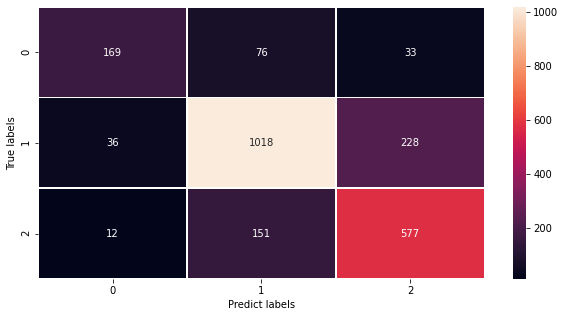

In [36]:
show_confusion_matrix(model_efficient, valid_loader)

##### Not Pretrained

###### Accuracy
![average accuracy (1)](https://user-images.githubusercontent.com/52006798/117941726-0c79ee00-b313-11eb-8458-32c2f40d772e.jpg)

###### Loss
![average loss (1)](https://user-images.githubusercontent.com/52006798/117941716-0ab02a80-b313-11eb-8e12-7bacad0784a8.jpg)

#### Examples

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  if __name__ == '__main__':


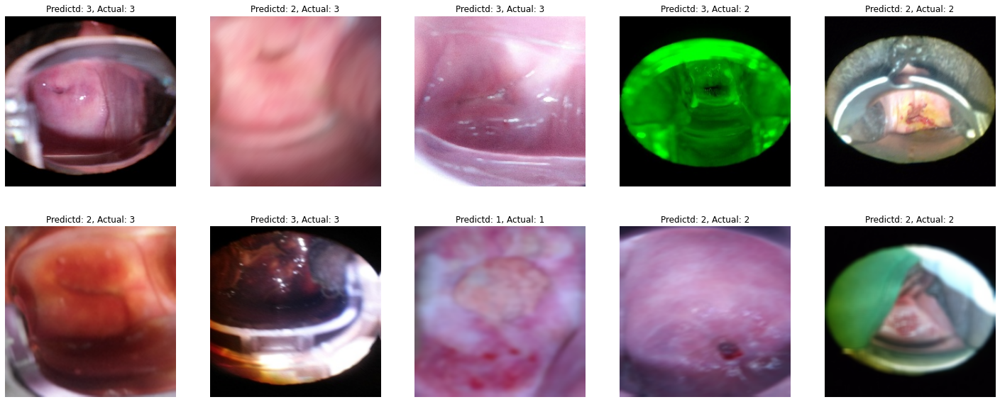

In [37]:
plot_examples(model_efficient, validset, 10)

### ResNet 50

In [38]:
experiment_resnet = 0

In [59]:
model_resnet = models.resnet50(pretrained=True)
in_features = model_resnet.fc.in_features
model_resnet.fc = torch.nn.Linear(in_features, 3)

Downloading: "https://download.pytorch.org/models/resnet50-19c8e357.pth" to /root/.cache/torch/hub/checkpoints/resnet50-19c8e357.pth


#### Training

In [60]:
start_epoch = 0

In [61]:
experiment_resnet += 1
epochs = 20
criterion = nn.CrossEntropyLoss()
optimizer = optim.AdamW(model_resnet.parameters(), lr=0.0001)

In [62]:
%%time
train_model(train_loader, valid_loader, model_resnet, optimizer, criterion, start_epoch, epochs, writer_name='resnet', exp_num=experiment_resnet)
start_epoch += epochs

resnet number 2
Epoch   1:	train loss: 0.825708,	train accuracy: 0.593849,	validation loss: 0.756175,	validation accuracy: 0.63913
Epoch   2:	train loss: 0.658572,	train accuracy: 0.704939,	validation loss: 0.721811,	validation accuracy: 0.66087
Epoch   3:	train loss: 0.4801,	train accuracy: 0.794035,	validation loss: 0.705736,	validation accuracy: 0.692174
Epoch   4:	train loss: 0.310523,	train accuracy: 0.875862,	validation loss: 0.762431,	validation accuracy: 0.71
Epoch   5:	train loss: 0.214702,	train accuracy: 0.918733,	validation loss: 1.00403,	validation accuracy: 0.691304
Epoch   6:	train loss: 0.183677,	train accuracy: 0.929543,	validation loss: 1.00231,	validation accuracy: 0.697826
Epoch   7:	train loss: 0.120654,	train accuracy: 0.956198,	validation loss: 0.901465,	validation accuracy: 0.725217
Epoch   8:	train loss: 0.0955616,	train accuracy: 0.965144,	validation loss: 0.880328,	validation accuracy: 0.758696
Epoch   9:	train loss: 0.0901163,	train accuracy: 0.968127,	valid

#### Results

##### Accuracy
![average accuracy (1)](https://user-images.githubusercontent.com/52006798/117940961-4e566480-b312-11eb-848d-173a6ff03624.jpg)


##### Loss
![average loss (1)](https://user-images.githubusercontent.com/52006798/117940955-4d253780-b312-11eb-85ef-f1ea04b43d19.jpg)


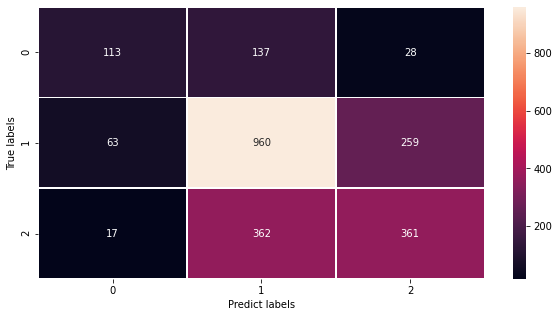

In [43]:
show_confusion_matrix(model_resnet, valid_loader)

#### Examples

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  if __name__ == '__main__':


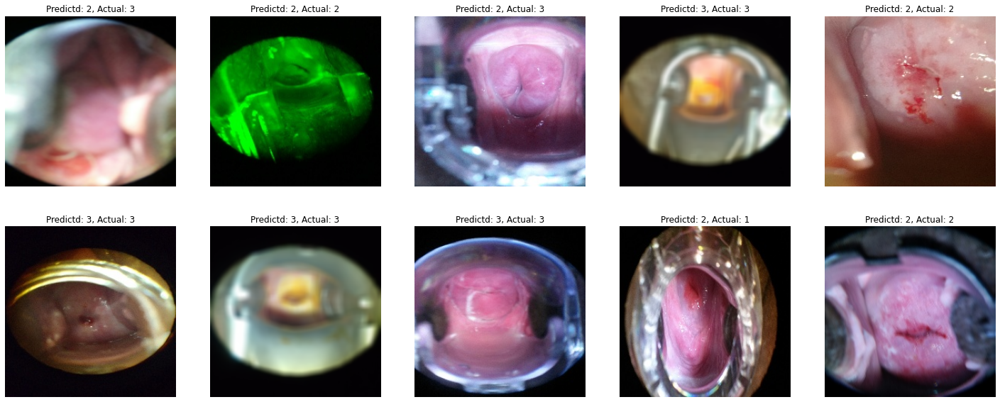

In [44]:
plot_examples(model_resnet, validset, 10)

### MobileNet V3

In [46]:
experiment_mobile = 0

In [47]:
model_mobile_net3 = models.mobilenet_v3_large(pretrained=True)
model_mobile_net3.classifier[3] = torch.nn.Linear(in_features=1280, out_features=3, bias=True)

Downloading: "https://download.pytorch.org/models/mobilenet_v3_large-8738ca79.pth" to /root/.cache/torch/hub/checkpoints/mobilenet_v3_large-8738ca79.pth


#### Training

In [50]:
start_epoch = 0

In [51]:
experiment_mobile += 1
epochs = 40
criterion = nn.CrossEntropyLoss()
optimizer = optim.AdamW(model_mobile_net3.parameters(), lr=0.001)

In [52]:
%%time
train_model(train_loader, valid_loader, model_mobile_net3, optimizer, criterion, start_epoch, epochs, writer_name='mobilenet', exp_num=experiment_mobile)
start_epoch += epochs

mobilenet number 2
Epoch   1:	train loss: 0.871866,	train accuracy: 0.58192,	validation loss: 1.02236,	validation accuracy: 0.547826
Epoch   2:	train loss: 0.776846,	train accuracy: 0.632246,	validation loss: 0.797277,	validation accuracy: 0.635652
Epoch   3:	train loss: 0.692118,	train accuracy: 0.683131,	validation loss: 0.756562,	validation accuracy: 0.664783
Epoch   4:	train loss: 0.613585,	train accuracy: 0.728052,	validation loss: 0.790245,	validation accuracy: 0.633043
Epoch   5:	train loss: 0.537113,	train accuracy: 0.771668,	validation loss: 0.816641,	validation accuracy: 0.613478
Epoch   6:	train loss: 0.438126,	train accuracy: 0.819571,	validation loss: 0.803807,	validation accuracy: 0.703913
Epoch   7:	train loss: 0.364317,	train accuracy: 0.85219,	validation loss: 0.910923,	validation accuracy: 0.69
Epoch   8:	train loss: 0.305657,	train accuracy: 0.884623,	validation loss: 0.791037,	validation accuracy: 0.715217
Epoch   9:	train loss: 0.228099,	train accuracy: 0.909226,	v

#### Results

##### Accuracy
![average accuracy (1)](https://user-images.githubusercontent.com/52006798/117941012-5c0bea00-b312-11eb-8aa0-e29912479427.jpg)


##### Loss
![average loss (1)](https://user-images.githubusercontent.com/52006798/117941020-5d3d1700-b312-11eb-9bd4-2ec07689eb12.jpg)

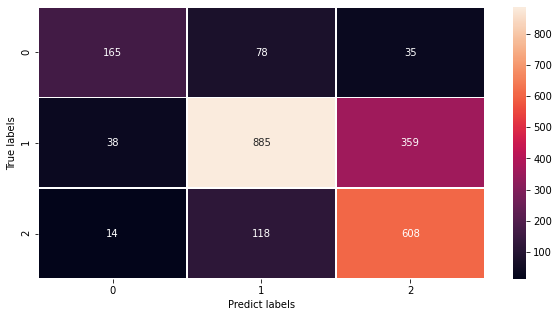

In [55]:
show_confusion_matrix(model_mobile_net3, valid_loader)

#### Examples

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  if __name__ == '__main__':


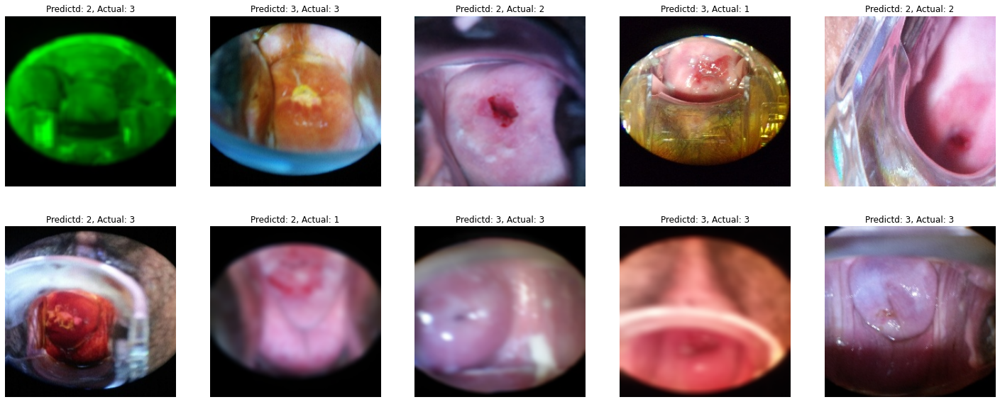

In [56]:
plot_examples(model_mobile_net3, validset, 10)